In [1]:
import cudf as gpd
import pandas as pd

In [2]:
df_gpu = gpd.read_csv("water-quality-1.csv")

In [5]:
df_gpu.isna().sum()

Sample ID                 0
Grab ID              376778
Profile ID                0
Sample Number             0
Collect DateTime          0
Depth (m)            376778
Site Type                 0
Area                    133
Locator                   0
Site                      0
Parameter                 0
Value                109085
Units                   780
QualityId                 0
Lab Qualifier       1110071
MDL                  651711
RDL                  653298
Text Value          1030752
Sample Info         1256301
Steward Note        1258764
Replicates          1257803
Replicate Of        1257913
Method               190439
Date Analyzed        691662
Data Source               0
dtype: int64

In [6]:
df_gpu.info()

<class 'cudf.core.dataframe.DataFrame'>
RangeIndex: 1259444 entries, 0 to 1259443
Data columns (total 25 columns):
 #   Column            Non-Null Count    Dtype
---  ------            --------------    -----
 0   Sample ID         1259444 non-null  int64
 1   Grab ID           882666 non-null   int64
 2   Profile ID        1259444 non-null  int64
 3   Sample Number     1259444 non-null  object
 4   Collect DateTime  1259444 non-null  object
 5   Depth (m)         882666 non-null   float64
 6   Site Type         1259444 non-null  object
 7   Area              1259311 non-null  object
 8   Locator           1259444 non-null  object
 9   Site              1259444 non-null  object
 10  Parameter         1259444 non-null  object
 11  Value             1150359 non-null  float64
 12  Units             1258664 non-null  object
 13  QualityId         1259444 non-null  int64
 14  Lab Qualifier     149373 non-null   object
 15  MDL               607733 non-null   float64
 16  RDL               6

In [8]:
df_gpu.describe(include='all')

,Sample ID,Grab ID,Profile ID,Sample Number,Collect DateTime,Depth (m),Site Type,Area,Locator,Site,...,MDL,RDL,Text Value,Sample Info,Steward Note,Replicates,Replicate Of,Method,Date Analyzed,Data Source
count,1259444.0,882666.0,1259444.0,1259444,1259444,882666.0,1259444,1259311,1259444,1259444,...,607733.0,606146.0,228692,3143,680,1641.0,1531.0,1069005,567782,1259444
unique,<NA>,<NA>,<NA>,154694,102284,<NA>,6,68,180,178,...,<NA>,<NA>,24857,354,65,<NA>,<NA>,203,4611,1
top,<NA>,<NA>,<NA>,L23545-1,10/20/1992 12:00:00 AM,<NA>,Large Lakes,Lake Washington,0852,Lake Washington Madison Park,...,<NA>,<NA>,N,nothing to note,Suspect method detection limit of 10 use with...,<NA>,<NA>,NONE,08/15/2018,KCEL
freq,<NA>,<NA>,<NA>,23,675,<NA>,760262,414928,114827,114827,...,<NA>,<NA>,15448,117,162,<NA>,<NA>,130214,1209,1259444
mean,80720.58648,88473.75364,42654.37331,<NA>,<NA>,10.602864,<NA>,<NA>,<NA>,<NA>,...,0.323792,1.900974,<NA>,<NA>,<NA>,105815.0646,112754.0536,<NA>,<NA>,<NA>
std,51681.91427,46349.58166,16599.86259,<NA>,<NA>,14.142444,<NA>,<NA>,<NA>,<NA>,...,0.495199,3.280455,<NA>,<NA>,<NA>,55902.77269,50282.68369,<NA>,<NA>,<NA>
min,531.0,700.0,4.0,<NA>,<NA>,0.0,<NA>,<NA>,<NA>,<NA>,...,0.0,0.0,<NA>,<NA>,<NA>,2824.0,2153.0,<NA>,<NA>,<NA>
25%,31912.0,54359.25,36472.75,<NA>,<NA>,1.0,<NA>,<NA>,<NA>,<NA>,...,0.01,0.04,<NA>,<NA>,<NA>,63136.0,63376.0,<NA>,<NA>,<NA>
50%,74828.0,86714.0,42731.0,<NA>,<NA>,6.0,<NA>,<NA>,<NA>,<NA>,...,0.5,1.0,<NA>,<NA>,<NA>,123467.0,127822.0,<NA>,<NA>,<NA>
75%,125789.0,125306.0,50258.0,<NA>,<NA>,15.0,<NA>,<NA>,<NA>,<NA>,...,0.5,1.0,<NA>,<NA>,<NA>,156988.0,157521.0,<NA>,<NA>,<NA>


In [9]:
data_sep = df_gpu[["Value", "Depth (m)"]]

In [10]:
import matplotlib.pyplot as plt

In [28]:
import cupy as cp
import holoviews as hv
import hvplot.cudf

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
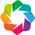

:Bars   [value]   (freq)

In [19]:
hv.extension("bokeh") # backend: bokeh/matplotlib/plotly

rand_arr = cp.random.randint(0, 20, 100)
rand_vals = gpd.Series(rand_arr).value_counts()

df = gpd.DataFrame(
    {
        "value": gpd.Series(rand_vals.index),
        "freq": rand_vals,
    }
)

# generate holoviews points chart using cudf DataFrame
hv.Bars(df, kdims="value", vdims="freq").opts(
     title="Bar Plot", width=500, height=400
)

In [41]:
df_sin_nulos = df_gpu["Value"].dropna()

In [45]:
df_sin_nulos1 = gpd.DataFrame(
    {
        "Values": df_sin_nulos,
        "XVal": df_sin_nulos.index
    }
)

In [46]:
df_sin_nulos1

,Values,XVal
0,0.07000,0
1,0.72700,1
2,18.90000,2
3,0.00724,3
4,8.94000,4
...,...,...
1259439,1.20000,1259439
1259440,0.90000,1259440
1259441,1020.00000,1259441
1259442,5.50000,1259442


In [66]:
df_sin_nulos1.hvplot.bar(x="XVal", y="Values")

:Bars   [XVal]   (Values)

In [48]:
df_sin_nulos1.describe()

,Values,XVal
count,1.150359e+06,1.150359e+06
mean,1.534332e+02,6.293523e+05
std,6.204438e+03,3.634067e+05
min,-1.600000e+00,0.000000e+00
25%,9.100000e-01,3.146375e+05
50%,7.630000e+00,6.293750e+05
75%,2.400000e+01,9.440635e+05
max,1.000000e+06,1.259443e+06


In [51]:
df_gpu["Units"].unique()

0           mg/L
1          deg C
2       umhos/cm
3           none
4           ug/L
5             pH
6            NTU
7       MPN/100g
8              m
9      CFU/100ml
10             %
11    mg CaCO3/L
12         mg/m3
13      ORG/100g
14          <NA>
15         kg/m3
16           PSS
17     ORG/100ml
18      umol/sm2
19     MPN/100ml
20         mg/Kg
21       % light
22           ppt
23           deg
Name: Units, dtype: object

In [52]:
df_sin_nulos1['values_smoth'] = df_sin_nulos1['Values'].rolling(window=3, min_periods=1).mean()

In [53]:
df_sin_nulos1

,Values,XVal,values_smoth
0,0.07000,0,0.070000
1,0.72700,1,0.398500
2,18.90000,2,6.565667
3,0.00724,3,6.544747
4,8.94000,4,9.282413
...,...,...,...
1259439,1.20000,1259439,334.066667
1259440,0.90000,1259440,334.033333
1259441,1020.00000,1259441,340.700000
1259442,5.50000,1259442,342.133333


In [55]:
import panel as pn
from matplotlib.figure import Figure

In [57]:
import seaborn as sns

In [59]:
df_sin_nulos_to_plot = df_sin_nulos1.to_pandas()

In [64]:
df_sin_nulos_to_plot = df_sin_nulos_to_plot.drop(df_sin_nulos_to_plot.index[-10000:])

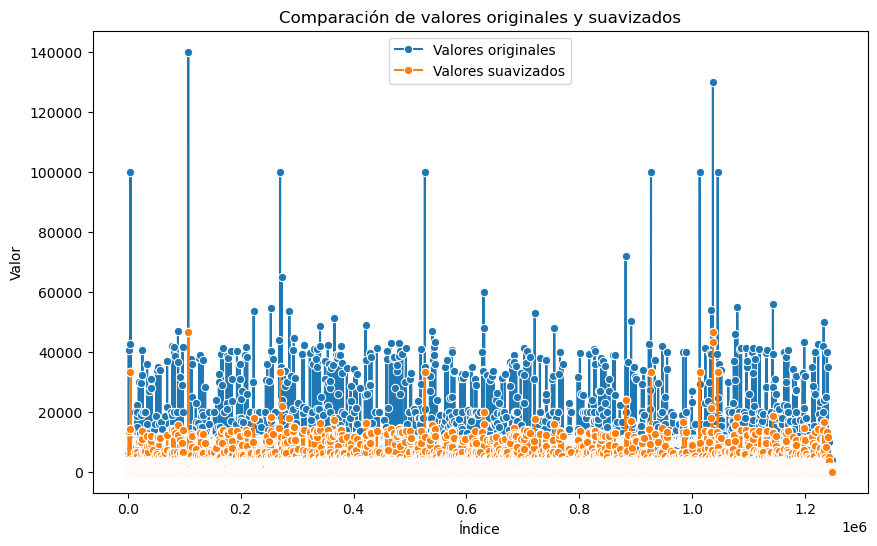

In [65]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=df_sin_nulos_to_plot, x=df_sin_nulos_to_plot.index, y='Values', label='Valores originales', marker='o')
sns.lineplot(data=df_sin_nulos_to_plot, x=df_sin_nulos_to_plot.index, y='values_smoth', label='Valores suavizados', marker='o')
plt.xlabel('Índice')
plt.ylabel('Valor')
plt.title('Comparación de valores originales y suavizados')
plt.legend()
plt.show()

In [69]:
import numpy as np

In [86]:
def gaussian_filter(serie):
    serie_np = serie # Convertir la serie de cuDF a un array de NumPy
    filtered = np.convolve(serie_np, kernel, mode='same')  # Aplicar la convolución
    return pd.Series(filtered)

In [81]:
window_size = 5
sigma = 1.0

# Crear el kernel gaussiano manualmente
kernel_size = window_size // 2
kernel = np.exp(-np.linspace(-kernel_size, kernel_size, window_size) ** 2 / (2 * sigma ** 2))
kernel = kernel / kernel.sum()  # Normalizar el kernel para que sume 1

In [88]:
df_sin_nulos_to_plot['valores_filtered'] = gaussian_filter(df_sin_nulos_to_plot['Values'])

In [89]:
df_sin_nulos_to_plot

,Values,XVal,values_smoth,valores_filtered
0,0.07000,0,0.070000,1.235554
1,0.72700,1,0.398500,4.925599
2,18.90000,2,6.565667,8.279762
3,0.00724,3,6.544747,8.034396
4,8.94000,4,9.282413,9.983569
...,...,...,...,...
1248033,7.50000,1248033,39.924667,NaN
1248034,7.03000,1248034,4.934667,NaN
1248035,6.77000,1248035,7.100000,NaN
1248036,1.59000,1248036,5.130000,NaN


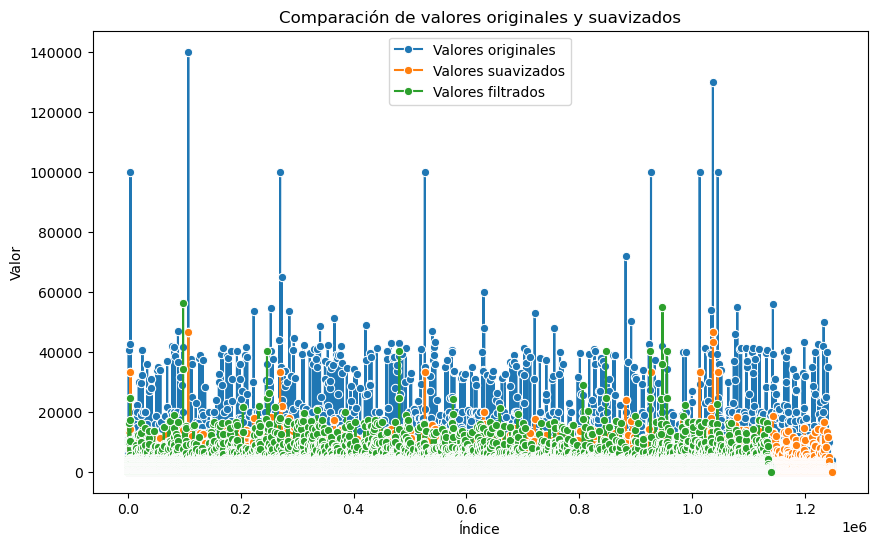

In [91]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=df_sin_nulos_to_plot, x=df_sin_nulos_to_plot.index, y='Values', label='Valores originales', marker='o')
sns.lineplot(data=df_sin_nulos_to_plot, x=df_sin_nulos_to_plot.index, y='values_smoth', label='Valores suavizados', marker='o')
sns.lineplot(data=df_sin_nulos_to_plot, x=df_sin_nulos_to_plot.index, y='valores_filtered', label='Valores filtrados', marker='o')
plt.xlabel('Índice')
plt.ylabel('Valor')
plt.title('Comparación de valores originales y suavizados')
plt.legend()
plt.show()